In [178]:
from collections import defaultdict
from matplotlib import pyplot as plt
import numpy as np
import operator
import pandas as pd
import pickle
import random
import scipy
from sklearn.metrics.pairwise import linear_kernel
from sklearn.neighbors import NearestNeighbors

import src.tools as tools
import src.recencytools as recency
import src.postprocess as postprocess
import src.preprocess as preprocess
import src.tfidftools as tfidftools

%load_ext autoreload
%autoreload 2
%matplotlib inline

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [179]:
path_to_data = 'data/'

training = pd.read_csv(path_to_data + 'training_set.csv', sep=',', header=0)

training_info = pd.read_csv(
    path_to_data + 'training_info.csv', sep=',', parse_dates=True, header=0)

test = pd.read_csv(path_to_data + 'test_set.csv', sep=',', header=0)

test_info = pd.read_csv(path_to_data + 'test_info.csv',
                        sep=',', parse_dates=True, header=0)
path_to_results = 'results/'

In [180]:
training_info

,mid,date,body,recipients
0,60,2000-07-25 08:14:00,Legal has been assessing the risks of doing bl...,robert.badeer@enron.com murray.o neil@enron.co...
1,66,2000-08-03 02:56:00,Attached is a spreadsheet to estimate export f...,kim.ward@enron.com robert.badeer@enron.com mur...
2,74,2000-08-15 05:37:00,Kevin/Bob: Here is a quick rundown on the cons...,robert.badeer@enron.com john.massey@enron.com ...
3,80,2000-08-20 14:12:00,check this out and let everyone know what s up...,robert.badeer@enron.com jeff.richter@enron.com
4,83,2000-08-22 08:17:00,Further to your letter to us (addressed to Mr....,pgillman@schiffhardin.com kamarlantes@calpx.co...
5,105,2000-08-24 11:42:00,The new version of the EnronOnline website is ...,dave.samuels@enron.com andy.zipper@enron.com l...
6,132,2000-08-27 23:11:00,Check this out. I think that we need to be si...,robert.badeer@enron.com greg.wolfe@enron.com l...
7,136,2000-08-28 02:50:00,We have had some confusion recently with respe...,robert.badeer@enron.com m..forney@enron.com ti...
8,144,2000-08-28 08:15:00,I will be traveling to Calgary on Tuesday and ...,robert.badeer@enron.com murray.o neil@enron.co...
9,167,2000-08-29 11:18:00,Please note that the EnronOnline Phase 2 train...,erik.simpson@enron.com paul.racicot@enron.com ...


In [3]:
test_info

,mid,date,body
0,1577,2001-11-19 06:59:51,Note: Stocks of heating oil are very high for...
1,1750,2002-03-05 08:46:57,"Kevin Hyatt and I are going for ""sghetti"" at S..."
2,1916,2002-02-13 14:17:39,This was forwarded to me and it is funny. - Wi...
3,2094,2002-01-22 11:33:56,I will be in to and happy to assist too. I ma...
4,2205,2002-01-11 07:12:19,Thanks. I needed a morning chuckle.
5,2297,2002-01-11 14:37:19,Note: Westpath Expansion plans filed at NEBTr...
6,5300,2001-11-26 14:13:01,Here are Peggy s slides. -----Original Message...
7,5333,2001-11-19 13:44:18,Here s the information. -----Original Message-...
8,6583,2002-01-18 05:00:48,I would like to know where and how this is goi...
9,7460,2001-11-12 16:43:31,"Richard: Per Elliot s e-mail below, do you hav..."


In [182]:
token_dict = preprocess.body_dict_from_panda(training_info)
test_mids = list(test_info['mid'])

Constructing dictionnary from dataframe...
0 / 43613
10000 / 43613
20000 / 43613
30000 / 43613
40000 / 43613
done !


In [54]:
path_to_tfidf_model = 'results/tfidf_model'
path_to_tfidf_matrix = 'results/tfidf_matrix'

In [ ]:
enumerate(token_dict)

If model not available at path_to_tfidf_model
Uncomment next cell, launch and recomment

In [183]:
tfidf_model, tfidf_matrix, tfidf_mids = tfidftools.get_tfidf(token_dict, 0.001, 0.10)

# Save to files
with open(path_to_tfidf_model, 'wb') as infile:
    pickle.dump(tfidf_model, infile)
with open(path_to_tfidf_matrix, 'wb') as infile:
    pickle.dump(tfidf_matrix, infile)

In [184]:
with open(path_to_tfidf_model, 'rb') as infile:
    tfidf_model = pickle.load(infile)
    
with open(path_to_tfidf_matrix, 'rb') as infile:
    tfidf_matrix = pickle.load(infile)

In [94]:
email_ids_per_sender = preprocess.get_email_ids_per_sender(training)
one_sender_mids = email_ids_per_sender['alan.aronowitz@enron.com']
email_ids_per_sender_test = preprocess.get_email_ids_per_sender(test)
email_ids_per_sender_test

{'alan.aronowitz@enron.com': ['235059',
  '171916',
  '177414',
  '326026',
  '176903',
  '117898',
  '172208',
  '176882',
  '37361',
  '178340',
  '176866',
  '101059',
  '176935',
  '176655',
  '176889',
  '176877',
  '377985',
  '326070',
  '117786',
  '172288'],
 'alan.comnes@enron.com': ['48283',
  '190159',
  '402288',
  '189695',
  '402233',
  '274330',
  '204919',
  '274533',
  '269312',
  '204920',
  '401900',
  '50936',
  '204580',
  '274308',
  '401709',
  '274423',
  '274563',
  '402317',
  '189732',
  '401854'],
 'alex@pira.com': ['286150',
  '285907',
  '285979',
  '286152',
  '285918',
  '285882',
  '392056',
  '286048',
  '285915',
  '285960',
  '285928',
  '286091',
  '286132',
  '286123',
  '286176',
  '286153',
  '286025',
  '286039',
  '286175',
  '286080'],
 'amr.ibrahim@enron.com': ['48260',
  '48465',
  '50344',
  '48268',
  '50330',
  '48237',
  '189979',
  '189708',
  '189705',
  '48391',
  '190215',
  '48411',
  '189704',
  '48267',
  '48430',
  '191476',
  '

In [185]:
def find_similar(vector, tfidf_matrix, top_n = 1000):
    # ref http://www.markhneedham.com/blog/2016/07/27/scitkit-learn-tfidf-and-cosine-similarity-for-computer-science-papers/
    cosine_similarities = linear_kernel(vector , tfidf_matrix).flatten()
    related_docs_indices = [i for i in cosine_similarities.argsort()[::-1]]
    return [(index, cosine_similarities[index]) for index in related_docs_indices][0:top_n]


# some_mid = 171916
# some_vector = tfidftools.get_tfidf_vector(171916, test_info, tfidf_model)
# find_similar(some_vector, tfidf_matrix,)

mid_recipient_scores = {}
counter = 0
for test_mid in test_mids:
    counter += 1
    query_vector = tfidftools.get_tfidf_vector(test_mid, test_info, tfidf_model)
    similars = find_similar(query_vector, tfidf_matrix)
    
    # Get mid in training set corresponding to best matches
    best_match_mid = [tfidf_mids[similar_item[0]] for similar_item in similars]
    
    # Get corresponding similarity scores
    best_match_scores = [similar_item[1] for similar_item in similars]
    test_mail_scores = defaultdict(lambda: 0)
    for train_mid, train_score in zip(best_match_mid, best_match_scores):
        recipients  = preprocess.get_recipients(training_info, train_mid)
        for recipient in recipients:
            test_mail_scores[recipient] += train_score
    mid_recipient_scores[test_mid] = test_mail_scores      
    if (counter % 100==0):
        print('processed {nb_test} test emails'.format(nb_test=counter))

processed 100 test emails
processed 200 test emails
processed 300 test emails
processed 400 test emails
processed 500 test emails
processed 600 test emails
processed 700 test emails
processed 800 test emails
processed 900 test emails
processed 1000 test emails
processed 1100 test emails
processed 1200 test emails
processed 1300 test emails
processed 1400 test emails
processed 1500 test emails
processed 1600 test emails
processed 1700 test emails
processed 1800 test emails
processed 1900 test emails
processed 2000 test emails
processed 2100 test emails
processed 2200 test emails
processed 2300 test emails


In [159]:
print(mid_recipient_scores)

{40962: defaultdict(<function <lambda> at 0x7f3138b29ae8>, {'jeff.dasovich@enron.com': 1.6396306785101529, 'lysa.akin@enron.com': 1.2553265750708182, 'jean.blair@enron.com': 0.40583562164318787, 'alan.comnes@enron.com': 1.6396306785101529, 'kenneth.cessac@enron.com': 0.13514205366783955, 'allison.navin@enron.com': 1.2553265750708182, 'carolyn.cooney@enron.com': 1.2553265750708182, 'ginger.dernehl@enron.com': 2.071758852927664, 'cooper.richey@enron.com': 0.38430410343933497, 'john.shelk@enron.com': 1.2553265750708182, 'raetta.zadow@enron.com': 1.2281285715138834, 'jean.dressler@enron.com': 1.2553265750708182, 'harry.woodson@enron.com': 0.13514205366783955, 'paul.kaufman@enron.com': 1.6396306785101529, 'robert.frank@enron.com': 1.2553265750708182, 'howard.fromer@enron.com': 1.2553265750708182, 'dwatkiss@bracepatt.com': 0.38430410343933497, 'donald.lassere@enron.com': 1.2553265750708182, 'lisa.sawyer@enron.com': 0.19218791713573721, 'mona.petrochko@enron.com': 1.2553265750708182, 'lora.su

In [186]:
knn_dic = {}
for mid in mid_recipient_scores:
    receiver_scores =  mid_recipient_scores[mid]
    sorted_cos_sim = sorted(receiver_scores.items(), key=operator.itemgetter(1), reverse=True)
    k_most = [elt[0] for elt in sorted_cos_sim[:10]]
    knn_dic[mid] = k_most

In [161]:
knn_dic

{40962: ['terry.kowalke@enron.com',
  'steven.j.kean@enron.com',
  'john.buchanan@enron.com',
  'ginger.dernehl@enron.com',
  'james.d.steffes@enron.com',
  'richard.shapiro@enron.com',
  'sarah.novosel@enron.com',
  'jeff.dasovich@enron.com',
  'alan.comnes@enron.com',
  'paul.kaufman@enron.com'],
 85335: ['marie.heard@enron.com',
  'sara.shackleton@enron.com',
  'tracy.ngo@enron.com',
  'elizabeth.sager@enron.com',
  's..bradford@enron.com',
  'barry.tycholiz@enron.com',
  'sarah.novosel@enron.com',
  'l..nicolay@enron.com',
  'richard.shapiro@enron.com',
  'marcus.nettelton@enron.com'],
 172034: ['james.d.steffes@enron.com',
  'steven.j.kean@enron.com',
  'louise.kitchen@enron.com',
  'richard.shapiro@enron.com',
  'mark.koenig@enron.com',
  'john.lavorato@enron.com',
  'kenneth.lay@enron.com',
  'james.derrick@enron.com',
  'sarah.novosel@enron.com',
  'greg.whalley@enron.com'],
 118799: ['no.address@enron.com',
  'darron.c.giron@enron.com',
  'dgiron1@houston.rr.com',
  'steven.j.

In [188]:
def write_results_ranked(predictions_per_sender,
                         path_to_results, results_name):
    """
    Writes results to csv file for kaggle submission
    result must be a dict {mid:[recipient1, recipient2, ...]}
    """
    with open(path_to_results + results_name, 'wb') as my_file:
        my_file.write(bytes('mid,recipients\n', 'UTF-8'))
        for mid, preds in predictions_per_sender.items():
            my_file.write(bytes(str(mid) + ',' +
                                    ' '.join(preds) + '\n', 'UTF-8'))


write_results_ranked(knn_dic,path_to_results, 'knn-k-1000.csv')

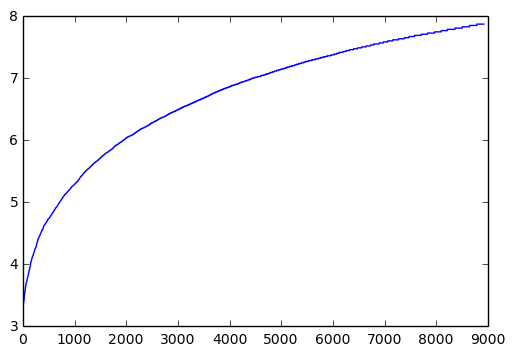

In [47]:
#print(tfidf.vocabulary_)
plt.plot(idfs)
plt.show()

In [144]:
test_info

,mid,date,body
0,1577,2001-11-19 06:59:51,Note: Stocks of heating oil are very high for...
1,1750,2002-03-05 08:46:57,"Kevin Hyatt and I are going for ""sghetti"" at S..."
2,1916,2002-02-13 14:17:39,This was forwarded to me and it is funny. - Wi...
3,2094,2002-01-22 11:33:56,I will be in to and happy to assist too. I ma...
4,2205,2002-01-11 07:12:19,Thanks. I needed a morning chuckle.
5,2297,2002-01-11 14:37:19,Note: Westpath Expansion plans filed at NEBTr...
6,5300,2001-11-26 14:13:01,Here are Peggy s slides. -----Original Message...
7,5333,2001-11-19 13:44:18,Here s the information. -----Original Message-...
8,6583,2002-01-18 05:00:48,I would like to know where and how this is goi...
9,7460,2001-11-12 16:43:31,"Richard: Per Elliot s e-mail below, do you hav..."


In [61]:
train_mids = list(training_info['mid'])
